## 1.Kütüphanelerin Eklenmesi


In [1]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
import cv2


## 2.Veri Setinin Belirlenmesi ve Kullanılacak Olan Sınıflar

In [2]:
# Veri seti yolu
dataset_path = "/kaggle/input/animals-with-attributes-2/Animals_with_Attributes2/JPEGImages"  # Veri setinin ana klasör yolu

# Kullanılacak sınıflar
selected_classes = ['collie', 'dolphin', 'elephant', 'fox', 'moose', 
                    'rabbit', 'sheep', 'squirrel', 'giant+panda', 'polar+bear']

# Sınıf klasörlerini filtreleyerek sadece gerekli sınıfları alınsın
data = []
labels = []
image_size = (128, 128)  # Resimlerin boyutları

for class_index, class_name in enumerate(selected_classes):
    class_path = os.path.join(dataset_path, class_name)
    if os.path.exists(class_path):
        for img_file in os.listdir(class_path)[:650]:  # Her sınıftan sadece 650 resim alınsın
            img_path = os.path.join(class_path, img_file)
            try:
                img = cv2.imread(img_path)
                img = cv2.resize(img, image_size)  # Boyutlandırma
                img = img / 255.0  # Normalize etme
                data.append(img)
                labels.append(class_index)
            except:
                continue

# Listeyi NumPy dizilerine dönüştürür
data = np.array(data, dtype="float32")
labels = np.array(labels, dtype="int")


## 3.Train ve Test Verilerinin Bölünmesi

In [3]:
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.3, random_state=42)

# Etiketleri one-hot encode eder
y_train = to_categorical(y_train, num_classes=len(selected_classes))
y_test = to_categorical(y_test, num_classes=len(selected_classes))


## 4.Veri Artırımı 
* Parametreler ve İşlevleri
* rotation_range=20:

Görüntüyü rastgele bir şekilde döndürür. Bu örnekte, döndürme açısı -20 ile +20 derece arasında olabilir.
* width_shift_range=0.2 ve height_shift_range=0.2:

Görüntüyü genişlik veya yükseklik boyunca rastgele kaydırır.
0.2, toplam görüntü genişliği veya yüksekliğinin %20'sine kadar kaydırma anlamına gelir.
* shear_range=0.2:

Görüntüyü kesme (shear) dönüşümüne tabi tutar. Bu, görüntünün bir paralelograma dönüştürülmesiyle sonuçlanır.
* zoom_range=0.2:

Görüntüyü rastgele yakınlaştırır veya uzaklaştırır. 0.2, %80 ile %120 arasında bir ölçeklendirme anlamına gelir.
* horizontal_flip=True:

Görüntüyü yatay olarak çevirir. Örneğin, bir resmin sağ tarafı sola döner.
Amaç
Bu işlemler, modelin sınırlı sayıda görüntüden öğrenmesi sırasında daha fazla çeşitlilik görmesini sağlar. Bu, modelin overfitting (ezberleme) yapmasını engellemeye yardımcı olur ve daha genelleştirilebilir hale getirir.

In [4]:
train_datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)

train_generator = train_datagen.flow(X_train, y_train, batch_size=32)


## 5.CNN Model OLuşturma
Modelin Yapısı
* 1.Konvolüsyon Katmanları (Conv2D):

Ne yapar? Görüntü üzerindeki kenarlar, dokular ve diğer özellikler gibi düşük seviyeli bilgileri öğrenir.
* Parametreler:
filters=64: 64 tane filtre uygular (özellik haritası oluşturur).
kernel_size=(3, 3): Filtrelerin boyutu.
activation='relu': ReLU aktivasyon fonksiyonu, negatif değerleri sıfırlar ve doğrusal olmayan bir yapı kazandırır.
input_shape=(128, 128, 3): İlk katmanda, giriş görüntüsünün boyutları belirtilir (128x128 boyutunda ve 3 kanallı renkli görüntüler).
* 2.Havuzlama Katmanları (MaxPooling2D):

Ne yapar? Özellik haritalarını küçülterek modelin daha az parametreyle çalışmasını ve overfitting'i azaltmasını sağlar.
* Parametreler:
pool_size=(2, 2): 2x2 boyutunda bir pencere kullanarak özellik haritasını küçültür.
* 3.Düzleştirme (Flatten):

Çok boyutlu veriyi tek boyutlu bir vektöre dönüştürür. Fully connected katmanlara veri gönderilmesini sağlar.
* Fully Connected Katmanlar (Dense):

* Ne yapar? Görüntüden çıkarılan özellikleri sınıflandırmak için kullanılır.
* 128 nöronlu Dense katman: Özelliklerin bir araya getirilerek sınıflandırmaya hazırlık yapılmasını sağlar.
* Dropout(0.3): Overfitting'i önlemek için, %30 oranında nöronları rastgele devre dışı bırakır.
* Softmax çıkış katmanı: 10 sınıf için her bir sınıfa ait olasılığı döndürür.

In [5]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

# Modeli oluştur
model = Sequential([
    # 1. Konvolüsyon Katmanı
    Conv2D(64, (3, 3), activation='relu', input_shape=(128, 128, 3)),
    MaxPooling2D((2, 2)),

    # 2. Konvolüsyon Katmanı
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),

    # 3. Konvolüsyon Katmanı
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),

    # Düzleştirme ve Fully Connected Katman
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.3),  # Overfitting'i azaltmak için dropout
    Dense(10, activation='softmax')  # 10 sınıf için softmax katmanı
])

# Modeli derleme
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

# Modelin özetini yazdır
model.summary()


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 126, 126, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 63, 63, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 61, 61, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 30, 30, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 28, 28, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 14, 14, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │       3,211,392 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 10)                  │           1,290 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,325,258 (12.68 MB)

 Trainable params: 3,325,258 (12.68 MB)

 Non-trainable params: 0 (0.00 B)

## 6.Modelin Eğitimi
* epochs=20: Modelin eğitim verisi üzerinde 20 kez tam bir geçiş yapmasını (epok) belirtir.
* validation_data=(X_test, y_test): Modelin eğitim sırasında doğruluk oranını test etmek için kullanılan doğrulama veri seti (test verisi).
* batch_size=32: Eğitim sırasında her seferinde modele verilecek örnek sayısını belirtir; burada 32 örnek bir arada işlenecek.

In [6]:
# Eğitim
history = model.fit(
    train_generator,  # Veri artırılmış eğitim seti
    epochs=20,
    validation_data=(X_test, y_test),
    batch_size=32
)


Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


143/143 ━━━━━━━━━━━━━━━━━━━━ 26s 139ms/step - accuracy: 0.1928 - loss: 2.1680 - val_accuracy: 0.3815 - val_loss: 1.7590
Epoch 2/20
143/143 ━━━━━━━━━━━━━━━━━━━━ 15s 103ms/step - accuracy: 0.3185 - loss: 1.8576 - val_accuracy: 0.3938 - val_loss: 1.6759
Epoch 3/20
143/143 ━━━━━━━━━━━━━━━━━━━━ 16s 104ms/step - accuracy: 0.3702 - loss: 1.7461 - val_accuracy: 0.4697 - val_loss: 1.5186
Epoch 4/20
143/143 ━━━━━━━━━━━━━━━━━━━━ 15s 103ms/step - accuracy: 0.4176 - loss: 1.6279 - val_accuracy: 0.5010 - val_loss: 1.4626
Epoch 5/20
143/143 ━━━━━━━━━━━━━━━━━━━━ 16s 104ms/step - accuracy: 0.4349 - loss: 1.5766 - val_accuracy: 0.5338 - val_loss: 1.3478
Epoch 6/20
143/143 ━━━━━━━━━━━━━━━━━━━━ 16s 105ms/step - accuracy: 0.4589 - loss: 1.4931 - val_accuracy: 0.5626 - val_loss: 1.3037
Epoch 7/20
143/143 ━━━━━━━━━━━━━━━━━━━━ 16s 104ms/step - accuracy: 0.5286 - loss: 1.3895 - val_accuracy: 0.5667 - val_loss: 1.2449
Epoch 8/20
143/143 ━━━━━━━━━━━━━━━━━━━━ 16s 104ms/step - accuracy: 0.5303 - loss: 1.3560 - val

## 7.Modelin Doğruluk Değerlerinin Görselleştirilmesi

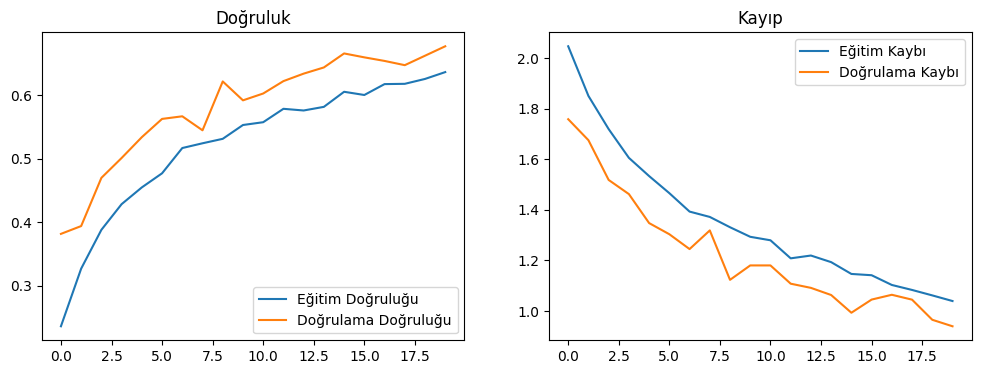

In [7]:
import matplotlib.pyplot as plt

# Doğruluk ve kayıp değerlerini görselleştir
plt.figure(figsize=(12, 4))

# Eğitim ve doğrulama doğruluğu
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Eğitim Doğruluğu')
plt.plot(history.history['val_accuracy'], label='Doğrulama Doğruluğu')
plt.title('Doğruluk')
plt.legend()

# Eğitim ve doğrulama kaybı
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Eğitim Kaybı')
plt.plot(history.history['val_loss'], label='Doğrulama Kaybı')
plt.title('Kayıp')
plt.legend()

plt.show()


In [8]:
test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=2)
print(f"Test Kaybı: {test_loss:.4f}")
print(f"Test Doğruluğu: {test_accuracy:.4f}")


61/61 - 1s - 8ms/step - accuracy: 0.6769 - loss: 0.9393
Test Kaybı: 0.9393
Test Doğruluğu: 0.6769


## 8.Manipüle Edilmiş Resimlerin Görselleştirilmesi

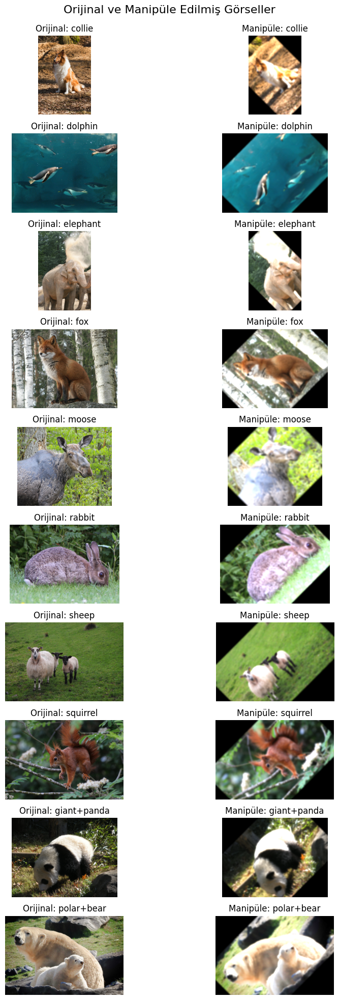

In [9]:
import os
import random
from PIL import Image, ImageFilter, ImageEnhance
import matplotlib.pyplot as plt

# Orijinal ve manipüle edilmiş görüntülerin dizinleri
original_images_dir = "/kaggle/input/animals-with-attributes-2/Animals_with_Attributes2/JPEGImages"  # Orijinal resimlerin yolu
manipulated_images_dir = "path_to_save_manipulated_images"  # Manipüle edilmiş resimleri kaydetme yolu

# Seçilen sınıflar
selected_classes = ['collie', 'dolphin', 'elephant', 'fox', 'moose', 
                    'rabbit', 'sheep', 'squirrel', 'giant+panda', 'polar+bear']

# Manipüle edilmiş dizini oluştur
os.makedirs(manipulated_images_dir, exist_ok=True)

def get_random_image(image_dir, class_name):
    """Belirtilen sınıftan rastgele bir görsel seç."""
    class_dir = os.path.join(image_dir, class_name)
    if not os.path.exists(class_dir):
        print(f"Sınıf için dizin bulunamadı: {class_name}")
        return None
    images = os.listdir(class_dir)
    if not images:
        print(f"Dizin boş: {class_name}")
        return None
    random_image_path = os.path.join(class_dir, random.choice(images))
    return Image.open(random_image_path), random_image_path

def manipulate_image(image):
    """Görsel üzerinde manipülasyon uygula."""
    # Görseli döndür
    manipulated = image.rotate(45)
    # Görseli bulanıklaştır
    manipulated = manipulated.filter(ImageFilter.GaussianBlur(radius=5))
    # Parlaklık artır
    enhancer = ImageEnhance.Brightness(manipulated)
    manipulated = enhancer.enhance(1.5)
    return manipulated

# Görselleştirme için veri hazırlama
original_images = []
manipulated_images = []

for class_name in selected_classes:
    original_image, image_path = get_random_image(original_images_dir, class_name)
    if original_image:
        original_images.append((class_name, original_image))
        
        # Manipülasyon uygula ve kaydet
        manipulated_image = manipulate_image(original_image)
        manipulated_images.append((class_name, manipulated_image))
        
        # Manipüle edilmiş resmi kaydet
        manipulated_class_dir = os.path.join(manipulated_images_dir, class_name)
        os.makedirs(manipulated_class_dir, exist_ok=True)
        save_path = os.path.join(manipulated_class_dir, os.path.basename(image_path))
        manipulated_image.save(save_path)

# Orijinal ve manipüle edilmiş görselleri yan yana görselleştir
fig, axes = plt.subplots(len(selected_classes), 2, figsize=(10, 20))
fig.suptitle("Orijinal ve Manipüle Edilmiş Görseller", fontsize=16)

for idx, (class_name, original_image) in enumerate(original_images):
    # Orijinal resim
    axes[idx, 0].imshow(original_image)
    axes[idx, 0].set_title(f"Orijinal: {class_name}")
    axes[idx, 0].axis("off")
    
    # Manipüle edilmiş resim
    manipulated_image = manipulated_images[idx][1]
    axes[idx, 1].imshow(manipulated_image)
    axes[idx, 1].set_title(f"Manipüle: {class_name}")
    axes[idx, 1].axis("off")

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()


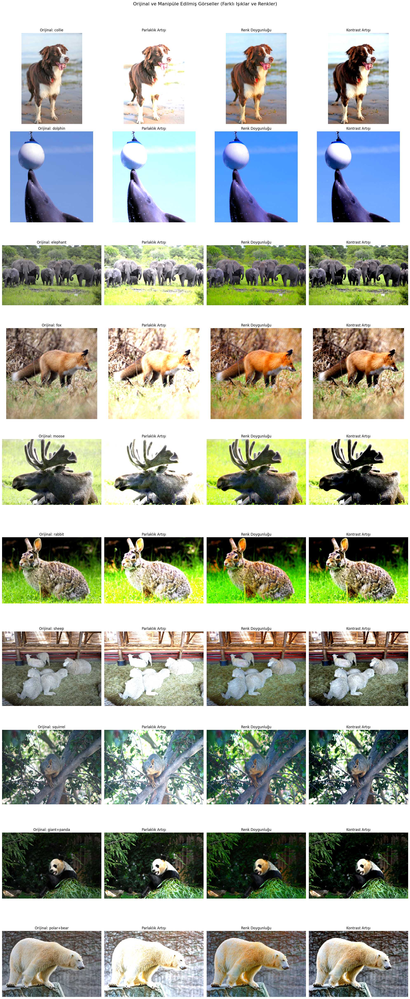

In [10]:
import os
import random
from PIL import Image, ImageEnhance
import matplotlib.pyplot as plt

# Orijinal ve manipüle edilmiş görüntülerin dizinleri
original_images_dir = "/kaggle/input/animals-with-attributes-2/Animals_with_Attributes2/JPEGImages"  # Orijinal resimlerin yolu
manipulated_images_dir = "path_to_save_manipulated_images"  # Manipüle edilmiş resimleri kaydetme yolu

# Seçilen sınıflar
selected_classes = ['collie', 'dolphin', 'elephant', 'fox', 'moose', 
                    'rabbit', 'sheep', 'squirrel', 'giant+panda', 'polar+bear']

# Manipüle edilmiş dizini oluştur
os.makedirs(manipulated_images_dir, exist_ok=True)

def get_random_image(image_dir, class_name):
    """Belirtilen sınıftan rastgele bir görsel seç."""
    class_dir = os.path.join(image_dir, class_name)
    if not os.path.exists(class_dir):
        print(f"Sınıf için dizin bulunamadı: {class_name}")
        return None
    images = os.listdir(class_dir)
    if not images:
        print(f"Dizin boş: {class_name}")
        return None
    random_image_path = os.path.join(class_dir, random.choice(images))
    return Image.open(random_image_path), random_image_path

def manipulate_image_light(image):
    """Işık manipülasyonu uygula."""
    enhancer = ImageEnhance.Brightness(image)
    bright_image = enhancer.enhance(1.8)  # Parlaklığı artır
    return bright_image

def manipulate_image_color(image):
    """Renk manipülasyonu uygula."""
    enhancer = ImageEnhance.Color(image)
    vibrant_image = enhancer.enhance(2.0)  # Renk doygunluğunu artır
    return vibrant_image

def manipulate_image_contrast(image):
    """Kontrast manipülasyonu uygula."""
    enhancer = ImageEnhance.Contrast(image)
    contrast_image = enhancer.enhance(1.5)  # Kontrastı artır
    return contrast_image

# Görselleştirme için veri hazırlama
original_images = []
manipulated_images = []

for class_name in selected_classes:
    original_image, image_path = get_random_image(original_images_dir, class_name)
    if original_image:
        original_images.append((class_name, original_image))
        
        # Farklı manipülasyonlar uygula
        manipulated_images_light = manipulate_image_light(original_image)
        manipulated_images_color = manipulate_image_color(original_image)
        manipulated_images_contrast = manipulate_image_contrast(original_image)
        
        # Kaydet ve listeye ekle
        manipulated_images.append((class_name, [manipulated_images_light, manipulated_images_color, manipulated_images_contrast]))
        
        # Manipüle edilmiş resimleri kaydet
        manipulated_class_dir = os.path.join(manipulated_images_dir, class_name)
        os.makedirs(manipulated_class_dir, exist_ok=True)
        
        manipulated_images_light.save(os.path.join(manipulated_class_dir, f"{class_name}_light.png"))
        manipulated_images_color.save(os.path.join(manipulated_class_dir, f"{class_name}_color.png"))
        manipulated_images_contrast.save(os.path.join(manipulated_class_dir, f"{class_name}_contrast.png"))

# Görselleştirme
fig, axes = plt.subplots(len(selected_classes), 4, figsize=(20, len(selected_classes) * 5))
fig.suptitle("Orijinal ve Manipüle Edilmiş Görseller (Farklı Işıklar ve Renkler)", fontsize=16)

for idx, (class_name, original_image) in enumerate(original_images):
    # Orijinal resim
    axes[idx, 0].imshow(original_image)
    axes[idx, 0].set_title(f"Orijinal: {class_name}")
    axes[idx, 0].axis("off")
    
    # Manipüle edilmiş resimler
    manipulated_light, manipulated_color, manipulated_contrast = manipulated_images[idx][1]
    
    axes[idx, 1].imshow(manipulated_light)
    axes[idx, 1].set_title("Parlaklık Artışı")
    axes[idx, 1].axis("off")
    
    axes[idx, 2].imshow(manipulated_color)
    axes[idx, 2].set_title("Renk Doygunluğu")
    axes[idx, 2].axis("off")
    
    axes[idx, 3].imshow(manipulated_contrast)
    axes[idx, 3].set_title("Kontrast Artışı")
    axes[idx, 3].axis("off")

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()


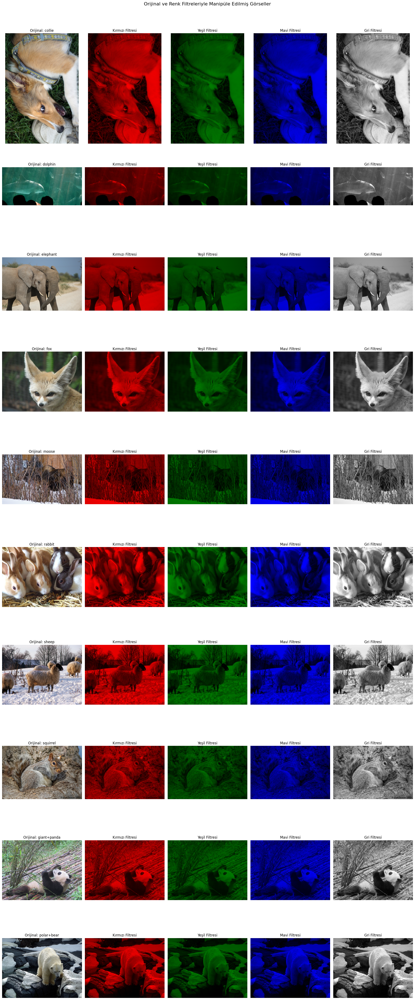

In [11]:
import os
import random
from PIL import Image, ImageEnhance, ImageOps
import matplotlib.pyplot as plt

# Orijinal ve manipüle edilmiş görüntülerin dizinleri
original_images_dir = "/kaggle/input/animals-with-attributes-2/Animals_with_Attributes2/JPEGImages"  # Orijinal resimlerin yolu
manipulated_images_dir = "path_to_save_manipulated_images"  # Manipüle edilmiş resimleri kaydetme yolu

# Seçilen sınıflar
selected_classes = ['collie', 'dolphin', 'elephant', 'fox', 'moose', 
                    'rabbit', 'sheep', 'squirrel', 'giant+panda', 'polar+bear']

# Manipüle edilmiş dizini oluştur
os.makedirs(manipulated_images_dir, exist_ok=True)

def get_random_image(image_dir, class_name):
    """Belirtilen sınıftan rastgele bir görsel seç."""
    class_dir = os.path.join(image_dir, class_name)
    if not os.path.exists(class_dir):
        print(f"Sınıf için dizin bulunamadı: {class_name}")
        return None
    images = os.listdir(class_dir)
    if not images:
        print(f"Dizin boş: {class_name}")
        return None
    random_image_path = os.path.join(class_dir, random.choice(images))
    return Image.open(random_image_path), random_image_path

def apply_color_filter(image, color):
    """Belirtilen renk filtresini uygula."""
    if color == "red":
        red_filter = ImageOps.colorize(ImageOps.grayscale(image), black="black", white="red")
        return red_filter
    elif color == "green":
        green_filter = ImageOps.colorize(ImageOps.grayscale(image), black="black", white="green")
        return green_filter
    elif color == "blue":
        blue_filter = ImageOps.colorize(ImageOps.grayscale(image), black="black", white="blue")
        return blue_filter
    elif color == "gray":
        return ImageOps.grayscale(image)
    return image

# Görselleştirme için veri hazırlama
original_images = []
manipulated_images = []

for class_name in selected_classes:
    original_image, image_path = get_random_image(original_images_dir, class_name)
    if original_image:
        original_images.append((class_name, original_image))
        
        # Farklı renk filtreleri uygula
        manipulated_red = apply_color_filter(original_image, "red")
        manipulated_green = apply_color_filter(original_image, "green")
        manipulated_blue = apply_color_filter(original_image, "blue")
        manipulated_gray = apply_color_filter(original_image, "gray")
        
        # Listeye ekle
        manipulated_images.append((class_name, [manipulated_red, manipulated_green, manipulated_blue, manipulated_gray]))
        
        # Manipüle edilmiş resimleri kaydet
        manipulated_class_dir = os.path.join(manipulated_images_dir, class_name)
        os.makedirs(manipulated_class_dir, exist_ok=True)
        
        manipulated_red.save(os.path.join(manipulated_class_dir, f"{class_name}_red.png"))
        manipulated_green.save(os.path.join(manipulated_class_dir, f"{class_name}_green.png"))
        manipulated_blue.save(os.path.join(manipulated_class_dir, f"{class_name}_blue.png"))
        manipulated_gray.save(os.path.join(manipulated_class_dir, f"{class_name}_gray.png"))

# Görselleştirme
fig, axes = plt.subplots(len(selected_classes), 5, figsize=(20, len(selected_classes) * 5))
fig.suptitle("Orijinal ve Renk Filtreleriyle Manipüle Edilmiş Görseller", fontsize=16)

for idx, (class_name, original_image) in enumerate(original_images):
    # Orijinal resim
    axes[idx, 0].imshow(original_image)
    axes[idx, 0].set_title(f"Orijinal: {class_name}")
    axes[idx, 0].axis("off")
    
    # Manipüle edilmiş resimler
    manipulated_red, manipulated_green, manipulated_blue, manipulated_gray = manipulated_images[idx][1]
    
    axes[idx, 1].imshow(manipulated_red)
    axes[idx, 1].set_title("Kırmızı Filtresi")
    axes[idx, 1].axis("off")
    
    axes[idx, 2].imshow(manipulated_green)
    axes[idx, 2].set_title("Yeşil Filtresi")
    axes[idx, 2].axis("off")
    
    axes[idx, 3].imshow(manipulated_blue)
    axes[idx, 3].set_title("Mavi Filtresi")
    axes[idx, 3].axis("off")
    
    axes[idx, 4].imshow(manipulated_gray, cmap="gray")
    axes[idx, 4].set_title("Gri Filtresi")
    axes[idx, 4].axis("off")

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()


In [12]:
def get_manipulated_images(images):
    manipulated_images = []
    for img in images:
        # Görüntüyü parlaklaştırma
        bright_img = cv2.convertScaleAbs(img, alpha=1.2, beta=30)
        manipulated_images.append(bright_img)

        # Görüntüyü karartma
        dark_img = cv2.convertScaleAbs(img, alpha=0.8, beta=-30)
        manipulated_images.append(dark_img)

        # Görüntüye gürültü ekleme
        noise = np.random.normal(0, 25, img.shape).astype('uint8')
        noisy_img = cv2.add(img.astype('uint8'), noise)
        manipulated_images.append(noisy_img)

    return np.array(manipulated_images)


In [13]:
manipulated_X_test = get_manipulated_images(X_test)
manipulated_X_test_normalized = manipulated_X_test / 255.0


In [14]:
print(f"manipulated_X_test shape: {manipulated_X_test.shape}")
print(f"y_test shape: {y_test.shape}")


manipulated_X_test shape: (5850, 128, 128, 3)
y_test shape: (1950, 10)


In [15]:
# Etiketleri çoğalt
manipulated_y_test = np.repeat(y_test, 3, axis=0)  # Her görüntü için 3 manipülasyon varsa

print(f"manipulated_y_test shape: {manipulated_y_test.shape}")


manipulated_y_test shape: (5850, 10)


In [16]:
manipulated_test_loss, manipulated_test_accuracy = model.evaluate(
    manipulated_X_test_normalized, manipulated_y_test, verbose=2
)

print(f"Manipüle Edilmiş Test Verisi - Kayıp: {manipulated_test_loss}, Doğruluk: {manipulated_test_accuracy}")


183/183 - 2s - 12ms/step - accuracy: 0.1022 - loss: 3.6414
Manipüle Edilmiş Test Verisi - Kayıp: 3.6413824558258057, Doğruluk: 0.10222221910953522


## 9.Renk Sabitleme

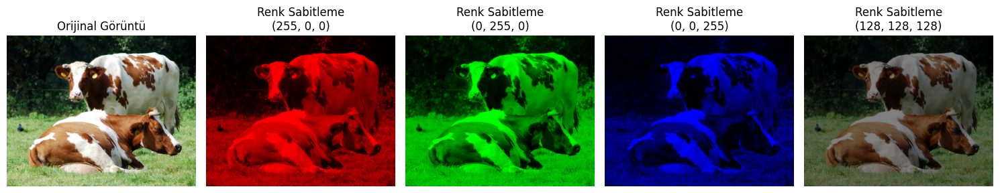

In [17]:
from PIL import Image, ImageEnhance
import matplotlib.pyplot as plt
import numpy as np

def color_balance(image, target_color):
    """
    Görüntüyü sabit bir renk tonuna ayarlar.
    :param image: Girdi görüntüsü (Pillow Image objesi)
    :param target_color: Hedef renk (RGB tuple, örn. (255, 0, 0) kırmızı)
    :return: Sabitlenmiş renk görüntüsü
    """
    # Görüntüyü normalize et
    image = image.convert("RGB")
    data = np.array(image)

    # Her kanal için renk oranlarını hesapla
    target_r, target_g, target_b = target_color
    r_ratio = target_r / 255
    g_ratio = target_g / 255
    b_ratio = target_b / 255

    # Yeni renkler için sabitleme
    data[..., 0] = (data[..., 0] * r_ratio).clip(0, 255)  # Kırmızı kanal
    data[..., 1] = (data[..., 1] * g_ratio).clip(0, 255)  # Yeşil kanal
    data[..., 2] = (data[..., 2] * b_ratio).clip(0, 255)  # Mavi kanal

    return Image.fromarray(data.astype("uint8"))

# Örnek görseli yükle
image_path = "/kaggle/input/animals-with-attributes-2/Animals_with_Attributes2/JPEGImages/cow/cow_10012.jpg"  # Girdi resminin yolu
original_image = Image.open(image_path)

# Sabit renk tonları
target_colors = [
    (255, 0, 0),  # Kırmızı
    (0, 255, 0),  # Yeşil
    (0, 0, 255),  # Mavi
    (128, 128, 128),  # Gri (ortalama)
]

# Sabitlenmiş görselleri oluştur
fixed_images = [color_balance(original_image, color) for color in target_colors]

# Görselleştirme
fig, axes = plt.subplots(1, len(fixed_images) + 1, figsize=(15, 5))
axes[0].imshow(original_image)
axes[0].set_title("Orijinal Görüntü")
axes[0].axis("off")

for i, (fixed_image, color) in enumerate(zip(fixed_images, target_colors)):
    axes[i + 1].imshow(fixed_image)
    axes[i + 1].set_title(f"Renk Sabitleme\n{color}")
    axes[i + 1].axis("off")

plt.tight_layout()
plt.show()


In [18]:
import numpy as np

def apply_gray_world(image):
    """
    Gray World algoritmasını uygulayarak renk sabitliği sağlar.
    """
    if len(image.shape) == 3:  # Renkli bir görüntü
        R_avg = np.mean(image[:, :, 0])  # Kırmızı kanal ortalaması
        G_avg = np.mean(image[:, :, 1])  # Yeşil kanal ortalaması
        B_avg = np.mean(image[:, :, 2])  # Mavi kanal ortalaması

        # Ortalama değerlere göre normalize et
        gray_image = np.zeros_like(image, dtype=np.float32)
        gray_image[:, :, 0] = image[:, :, 0] * (G_avg / R_avg)
        gray_image[:, :, 1] = image[:, :, 1]
        gray_image[:, :, 2] = image[:, :, 2] * (G_avg / B_avg)

        # Normalize edilmiş görüntüyü 0-255 aralığına getir
        gray_image = np.clip(gray_image, 0, 255).astype('uint8')
        return gray_image
    else:
        return image  # Siyah beyaz görüntülerde işlem yapma


In [19]:
def get_wb_images(images):
    """
    Manipüle edilmiş test setine renk sabitliği uygular.
    """
    wb_images = []
    for img in images:
        wb_img = apply_gray_world(img)
        wb_images.append(wb_img)
    return np.array(wb_images)


In [20]:
# Renk sabitliği uygulanmış test seti
wb_X_test = get_wb_images(manipulated_X_test)
print(f"Renk sabitliği uygulanmış test setinin boyutu: {wb_X_test.shape}")


Renk sabitliği uygulanmış test setinin boyutu: (5850, 128, 128, 3)


In [21]:
wb_X_test_normalized = wb_X_test / 255.0  # Normalizasyon


In [22]:
print(f"wb_X_test_normalized boyutu: {wb_X_test_normalized.shape}")
print(f"y_test boyutu: {y_test.shape}")


wb_X_test_normalized boyutu: (5850, 128, 128, 3)
y_test boyutu: (1950, 10)


In [23]:
# Giriş ve etiketlerin boyutlarını eşleştir
min_samples = min(len(wb_X_test_normalized), len(y_test))
wb_X_test_normalized = wb_X_test_normalized[:min_samples]
y_test = y_test[:min_samples]


In [24]:
wb_test_loss, wb_test_accuracy = model.evaluate(
    wb_X_test_normalized, y_test, verbose=2
)

print(f"Renk Sabitliği Uygulanmış Test Verisi - Kayıp: {wb_test_loss}, Doğruluk: {wb_test_accuracy}")


61/61 - 1s - 8ms/step - accuracy: 0.0908 - loss: 3.6989
Renk Sabitliği Uygulanmış Test Verisi - Kayıp: 3.698892593383789, Doğruluk: 0.09076923131942749


In [25]:
test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=2)
print(f"Test Kaybı: {test_loss:.4f}")
print(f"Test Doğruluğu: {test_accuracy:.4f}")

61/61 - 0s - 8ms/step - accuracy: 0.6769 - loss: 0.9393
Test Kaybı: 0.9393
Test Doğruluğu: 0.6769


In [26]:
manipulated_test_loss, manipulated_test_accuracy = model.evaluate(
    manipulated_X_test_normalized, manipulated_y_test, verbose=2
)

print(f"Manipüle Edilmiş Test Verisi - Kayıp: {manipulated_test_loss}, Doğruluk: {manipulated_test_accuracy}")


183/183 - 1s - 7ms/step - accuracy: 0.1022 - loss: 3.6414
Manipüle Edilmiş Test Verisi - Kayıp: 3.6413824558258057, Doğruluk: 0.10222221910953522
